# Clustering Analysis

In [2]:
# Necessary libraries

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from scipy.cluster import hierarchy
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split
from scipy.cluster.hierarchy import dendrogram, linkage
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 250
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [3]:
# Importing Dataset

df = pd.read_excel(r"C:\Users\shoai\Downloads\Lokesh Assignments (Excel R)\Clustering\EastWestAirlines.xlsx", sheet_name='data')
df

,ID#,Balance,Qual_miles,cc1_miles,cc2_miles,cc3_miles,Bonus_miles,Bonus_trans,Flight_miles_12mo,Flight_trans_12,Days_since_enroll,Award?
0,1,28143,0,1,1,1,174,1,0,0,7000,0
1,2,19244,0,1,1,1,215,2,0,0,6968,0
2,3,41354,0,1,1,1,4123,4,0,0,7034,0
3,4,14776,0,1,1,1,500,1,0,0,6952,0
4,5,97752,0,4,1,1,43300,26,2077,4,6935,1
...,...,...,...,...,...,...,...,...,...,...,...,...
3994,4017,18476,0,1,1,1,8525,4,200,1,1403,1
3995,4018,64385,0,1,1,1,981,5,0,0,1395,1
3996,4019,73597,0,3,1,1,25447,8,0,0,1402,1
3997,4020,54899,0,1,1,1,500,1,500,1,1401,0


In [4]:
df.describe()

,ID#,Balance,Qual_miles,cc1_miles,cc2_miles,cc3_miles,Bonus_miles,Bonus_trans,Flight_miles_12mo,Flight_trans_12,Days_since_enroll,Award?
count,3999.000000,3.999000e+03,3999.000000,3999.000000,3999.000000,3999.000000,3999.000000,3999.00000,3999.000000,3999.000000,3999.00000,3999.000000
mean,2014.819455,7.360133e+04,144.114529,2.059515,1.014504,1.012253,17144.846212,11.60190,460.055764,1.373593,4118.55939,0.370343
std,1160.764358,1.007757e+05,773.663804,1.376919,0.147650,0.195241,24150.967826,9.60381,1400.209171,3.793172,2065.13454,0.482957
min,1.000000,0.000000e+00,0.000000,1.000000,1.000000,1.000000,0.000000,0.00000,0.000000,0.000000,2.00000,0.000000
25%,1010.500000,1.852750e+04,0.000000,1.000000,1.000000,1.000000,1250.000000,3.00000,0.000000,0.000000,2330.00000,0.000000
50%,2016.000000,4.309700e+04,0.000000,1.000000,1.000000,1.000000,7171.000000,12.00000,0.000000,0.000000,4096.00000,0.000000
75%,3020.500000,9.240400e+04,0.000000,3.000000,1.000000,1.000000,23800.500000,17.00000,311.000000,1.000000,5790.50000,1.000000
max,4021.000000,1.704838e+06,11148.000000,5.000000,3.000000,5.000000,263685.000000,86.00000,30817.000000,53.000000,8296.00000,1.000000


- The columns Balance, Qual_miles, Bonus_miles, Flight_miles_12mo, Days_since_enroll have outliers present in them.
- But, let's confirm it in Scatter plot. 

In [6]:
df.isna().sum()

ID#                  0
Balance              0
Qual_miles           0
cc1_miles            0
cc2_miles            0
cc3_miles            0
Bonus_miles          0
Bonus_trans          0
Flight_miles_12mo    0
Flight_trans_12      0
Days_since_enroll    0
Award?               0
dtype: int64

- No missing values present.

In [8]:
df.duplicated().sum()

0

- No duplicate values as well.

In [10]:
df.dtypes

ID#                  int64
Balance              int64
Qual_miles           int64
cc1_miles            int64
cc2_miles            int64
cc3_miles            int64
Bonus_miles          int64
Bonus_trans          int64
Flight_miles_12mo    int64
Flight_trans_12      int64
Days_since_enroll    int64
Award?               int64
dtype: object

In [11]:
df.shape

(3999, 12)

# Data Preprocessing & Data Visualization

In [13]:
df.drop('ID#', axis=1, inplace=True)

In [14]:
df

,Balance,Qual_miles,cc1_miles,cc2_miles,cc3_miles,Bonus_miles,Bonus_trans,Flight_miles_12mo,Flight_trans_12,Days_since_enroll,Award?
0,28143,0,1,1,1,174,1,0,0,7000,0
1,19244,0,1,1,1,215,2,0,0,6968,0
2,41354,0,1,1,1,4123,4,0,0,7034,0
3,14776,0,1,1,1,500,1,0,0,6952,0
4,97752,0,4,1,1,43300,26,2077,4,6935,1
...,...,...,...,...,...,...,...,...,...,...,...
3994,18476,0,1,1,1,8525,4,200,1,1403,1
3995,64385,0,1,1,1,981,5,0,0,1395,1
3996,73597,0,3,1,1,25447,8,0,0,1402,1
3997,54899,0,1,1,1,500,1,500,1,1401,0


In [15]:
df.rename(columns={'Flight_miles_12mo' : 'FlghtMiles(12mnth)', 'Flight_trans_12' : 'FlghtTrans(12mnth)'}, inplace=True)

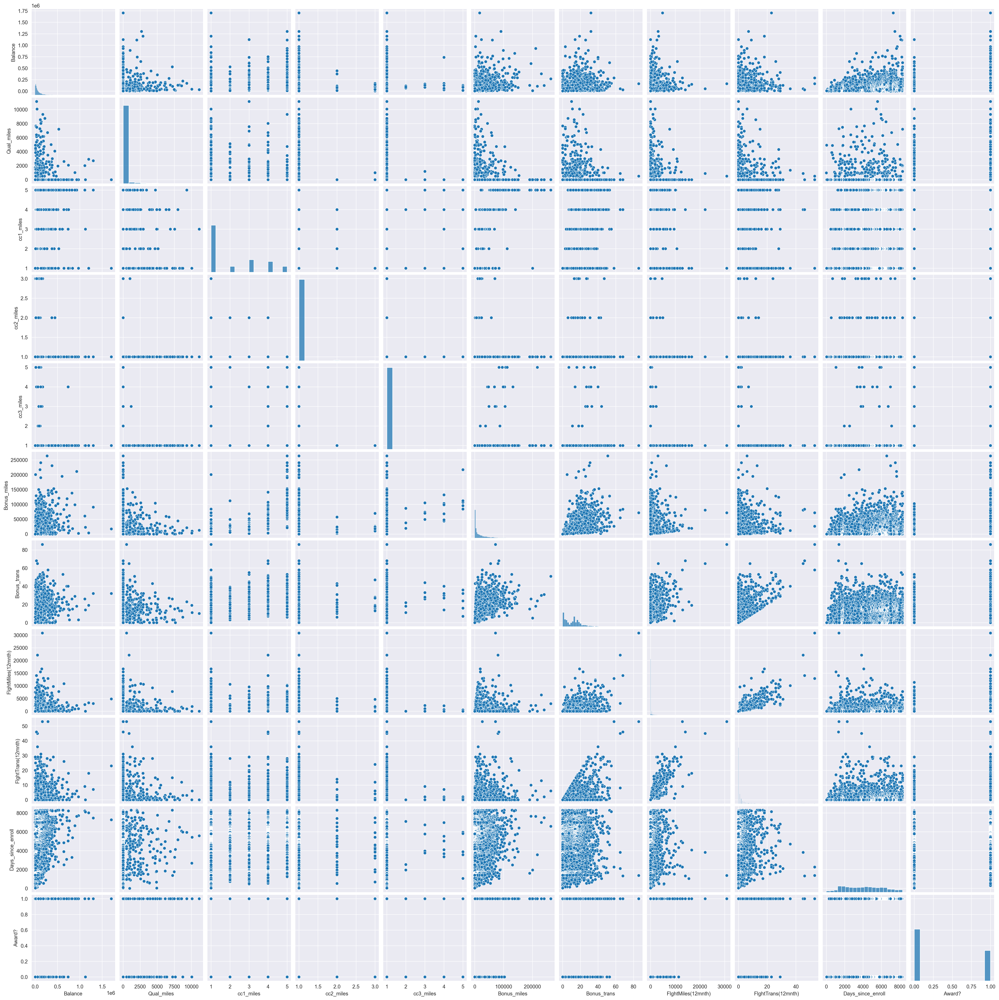

In [16]:
sns.pairplot(df)

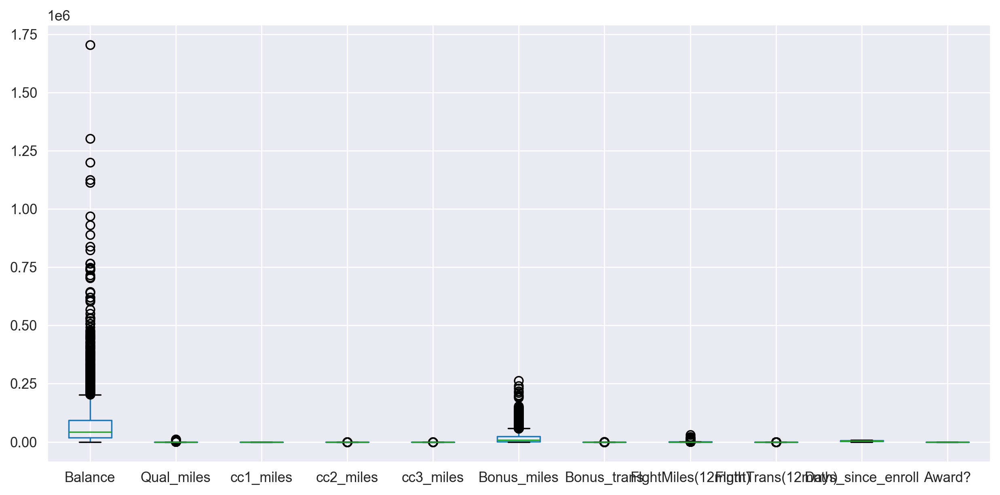

In [17]:
df.boxplot()
plt.tight_layout()

- The columns Balance, Qual_miles, cc2_miles, cc3_miles, Bonus_miles, Flight_miles_12mo, Days_since_enroll, Flight_miles_12mo, Flight_trans_12 have outliers.

In [19]:
df.columns

Index(['Balance', 'Qual_miles', 'cc1_miles', 'cc2_miles', 'cc3_miles',
       'Bonus_miles', 'Bonus_trans', 'FlghtMiles(12mnth)',
       'FlghtTrans(12mnth)', 'Days_since_enroll', 'Award?'],
      dtype='object')

In [20]:
# Using capping method to replace outliers

def capping(data, columns):
    for col in columns:
        q1 = data[col].quantile(0.25)
        q3 = data[col].quantile(0.75)
        iqr = q3-q1
    
        lower = q1-(1.5*iqr)
        upper = q3+(1.5*iqr)
        
        df[col] = np.where(df[col] > upper, upper, np.where(df[col] < lower, lower,df[col]))

In [21]:
capping(df, df.columns)

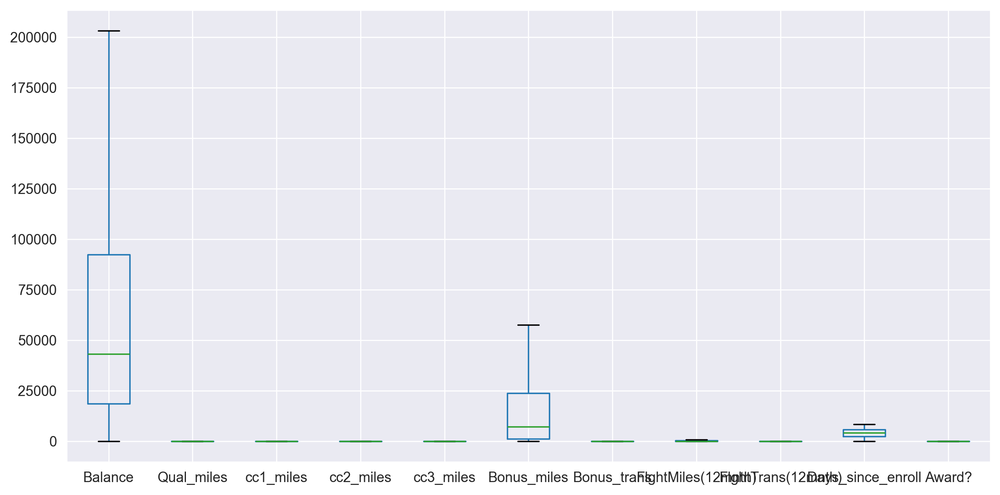

In [22]:
df.boxplot()
plt.tight_layout()

<Axes: >

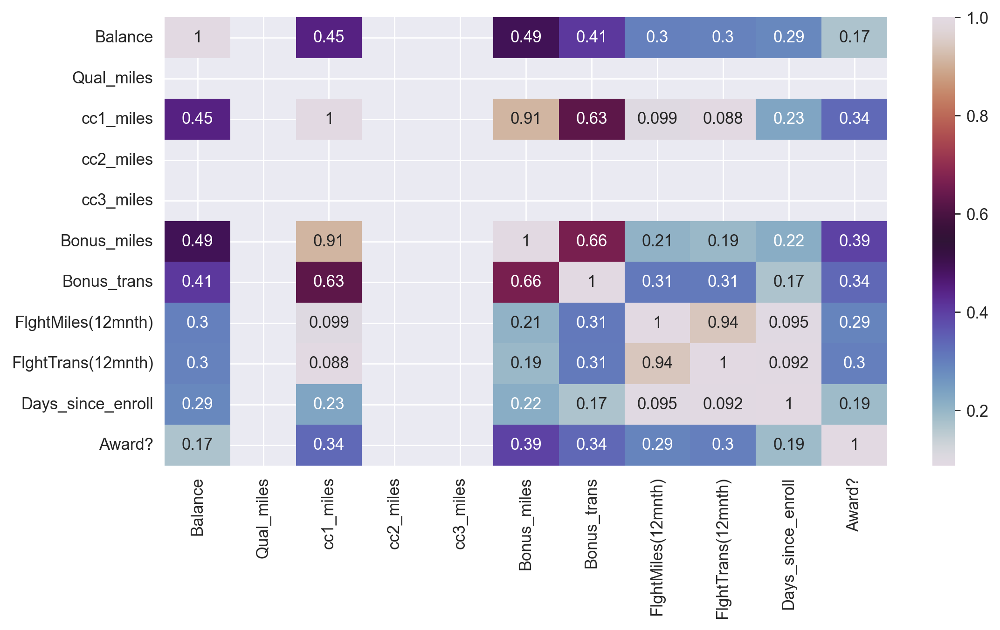

In [23]:
sns.heatmap(df.corr(), annot=True, cmap='twilight')

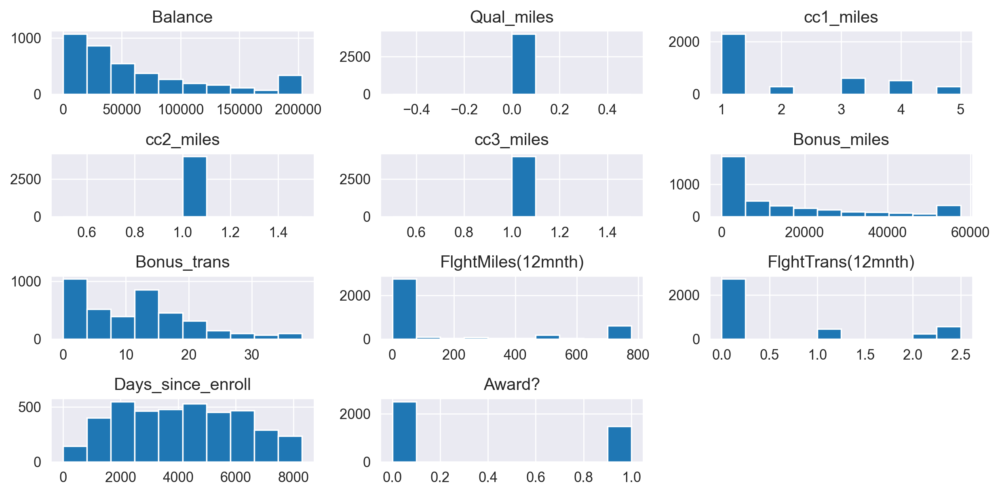

In [24]:
df.hist()
plt.tight_layout()

In [25]:
# Scaling The Data

sc = StandardScaler()

x = sc.fit_transform(df)
x

array([[-0.60725829,  0.        , -0.76957841, ..., -0.62614341,
         1.39545434, -0.7669193 ],
       [-0.75894657,  0.        , -0.76957841, ..., -0.62614341,
         1.37995704, -0.7669193 ],
       [-0.38206963,  0.        , -0.76957841, ..., -0.62614341,
         1.41192021, -0.7669193 ],
       ...,
       [ 0.1675298 ,  0.        ,  0.68312117, ..., -0.62614341,
        -1.31560393,  1.30391816],
       [-0.15118775,  0.        , -0.76957841, ...,  0.43238439,
        -1.31608822, -0.7669193 ],
       [-1.03556163,  0.        , -0.76957841, ..., -0.62614341,
        -1.31754109, -0.7669193 ]])

# Implementing Clustering Algorithms

1. K-Means Clustering

In [27]:
inertia = []
K = range(1, 11)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(x)
    inertia.append(kmeans.inertia_)

In [28]:
inertia

[31992.000000000015,
 22258.920496470186,
 17745.919737000077,
 15198.32170336316,
 13695.516140835714,
 12483.019847053263,
 11965.020673262703,
 10775.100709237817,
 10307.924390696775,
 9666.362395344011]

Text(0, 0.5, 'Inertia')

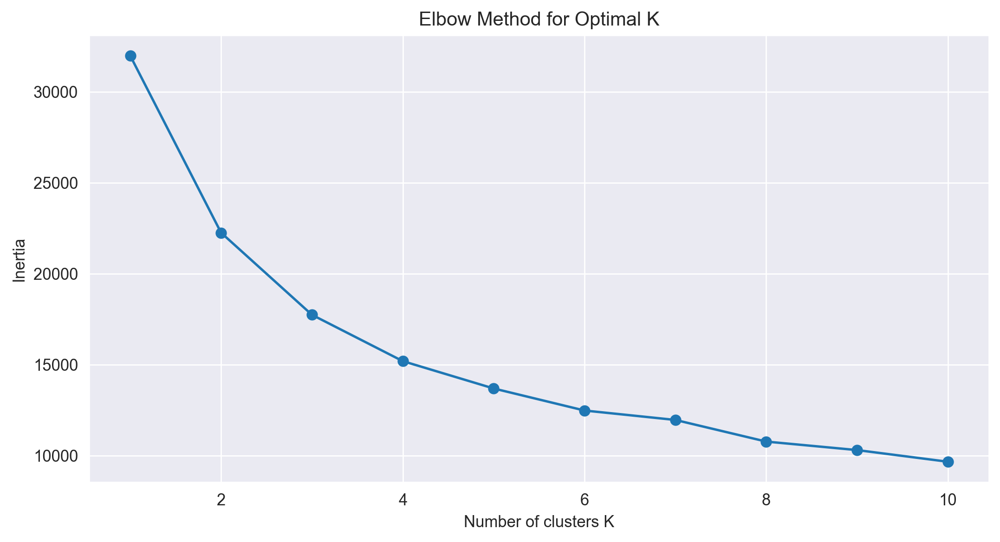

In [29]:
# Plotting the elbow curve
plt.figure()
plt.plot(K, inertia, marker='o')
plt.title('Elbow Method for Optimal K')
plt.xlabel('Number of clusters K')
plt.ylabel('Inertia')

In [30]:
# Fit K-Means with optimal K
optimal_k = 3
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans_labels = kmeans.fit_predict(x)

In [31]:
# Evaluate silhouette score
silhouette_kmeans = silhouette_score(x, kmeans_labels)
print(f'Silhouette Score for K-Means: {silhouette_kmeans}')

Silhouette Score for K-Means: 0.32931591228742907


- A poor Silhouette Score for the K-Means Clustering.

2. Hierarchical Clustering

Text(0.5, 1.0, 'Dendrogram for Hierarchical Clustering')

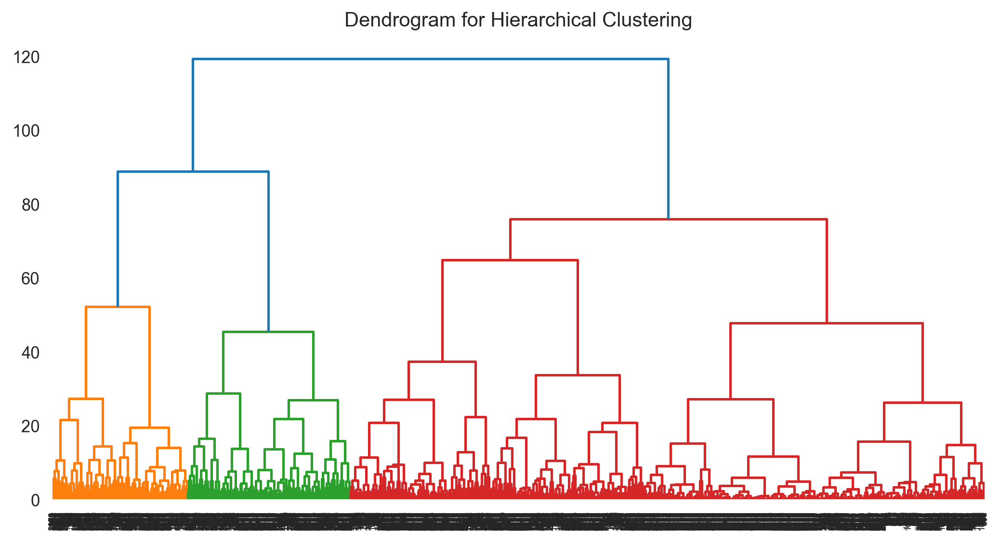

In [34]:
plt.figure()
linked = linkage(x, 'ward')
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title('Dendrogram for Hierarchical Clustering')

In [35]:
# Fit hierarchical clustering (e.g., cutting the dendrogram at a certain level)
hierarchical = AgglomerativeClustering(n_clusters=3)
hierarchical_labels = hierarchical.fit_predict(x)

In [36]:
# Evaluate silhouette score
silhouette_hierarchical = silhouette_score(x, hierarchical_labels)
print(f'Silhouette Score for Hierarchical Clustering: {silhouette_hierarchical}')

Silhouette Score for Hierarchical Clustering: 0.25553610801899945


3. DBScan Clustering

Text(0, 0.5, 'Epsilon distance')

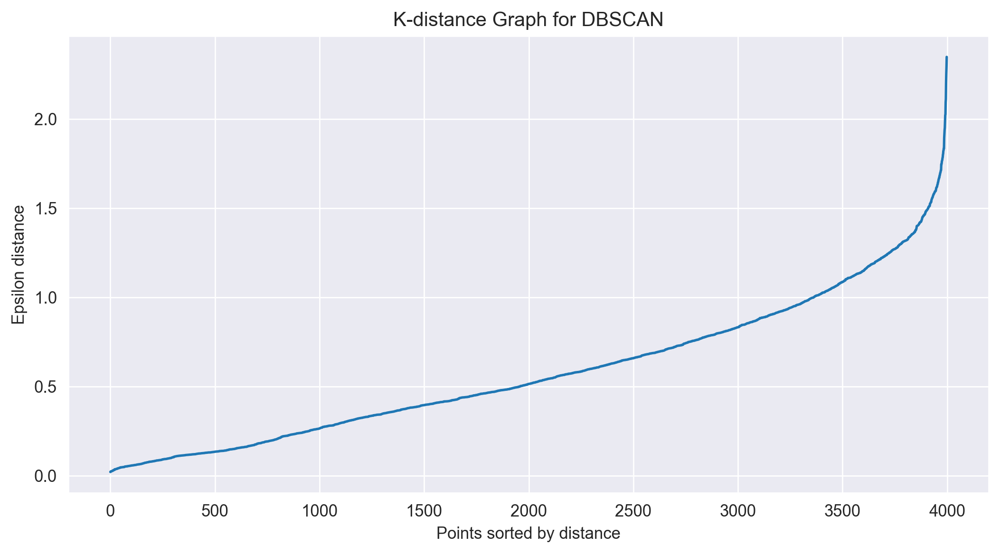

In [38]:
# DBSCAN
neighbors = NearestNeighbors(n_neighbors=5)
neighbors_fit = neighbors.fit(x)
distances, indices = neighbors_fit.kneighbors(x)
distances = np.sort(distances[:, 4], axis=0)
plt.plot(distances)
plt.title('K-distance Graph for DBSCAN')
plt.xlabel('Points sorted by distance')
plt.ylabel('Epsilon distance')

In [39]:
# Choose epsilon and minPts
epsilon = 0.3
minPts = 5
dbscan = DBSCAN(eps=epsilon, min_samples=minPts)
dbscan_labels = dbscan.fit_predict(x)

In [40]:
if len(set(dbscan_labels)) > 1:  # Check if there are more than one cluster
    dbscan_silhouette = silhouette_score(x, dbscan_labels)
    print(f'Silhouette Score for DBSCAN: {dbscan_silhouette}')
else:
    print('DBSCAN did not find any clusters.')

Silhouette Score for DBSCAN: -0.35035425689789385


- The Epsilon Value '0.3' gives the highest Silhouette Score.

# Hyperparameter Tuning for each Clustering Method

1. K-Means Clustering

In [43]:
k_values = range(2, 15)
silhouette_scores = []

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(x)
    score = silhouette_score(x, kmeans.labels_)
    silhouette_scores.append(score)

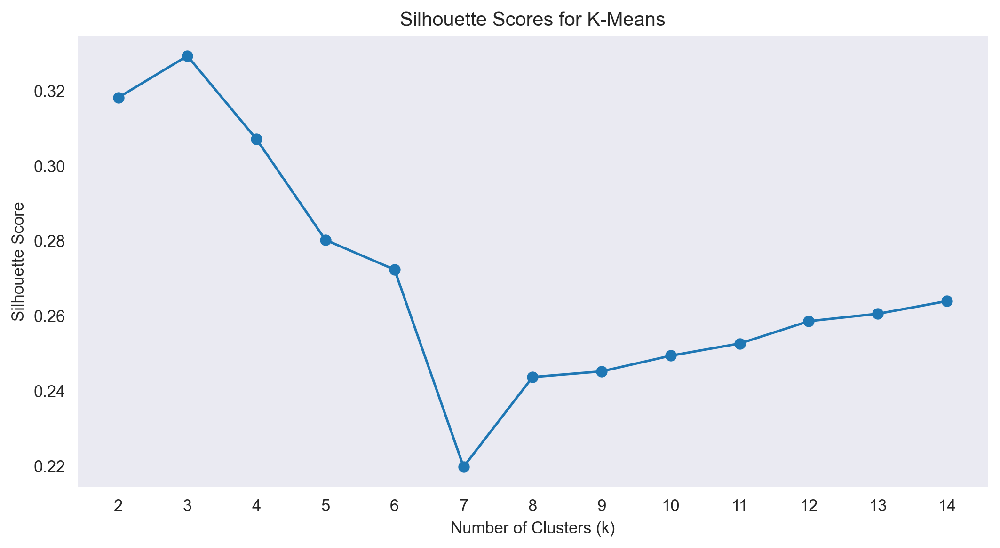

In [44]:
# Plotting the silhouette scores

plt.figure()
plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Scores for K-Means')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.xticks(k_values)
plt.grid()

In [45]:
optimal_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Optimal number of clusters for K-Means: {optimal_k}')

Optimal number of clusters for K-Means: 3


2. Hierarchical Clustering

In [47]:
# Range of n_clusters values
n_clusters_range = range(2, 15)
hierarchical_silhouette_scores = []

for n_clusters in n_clusters_range:
    hierarchical = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = hierarchical.fit_predict(x)
    score = silhouette_score(x, labels)
    hierarchical_silhouette_scores.append(score)

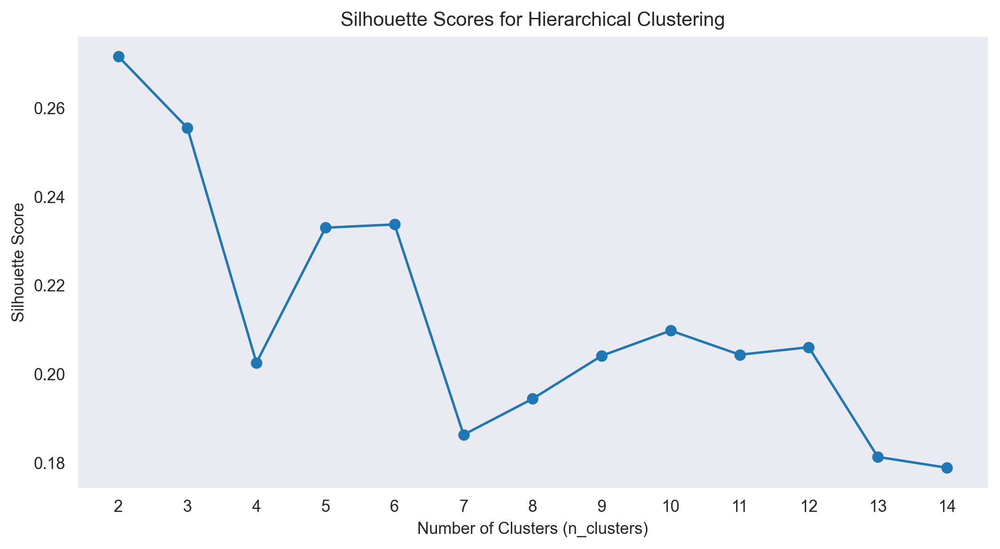

In [48]:
# Plotting the silhouette scores
plt.figure()
plt.plot(n_clusters_range, hierarchical_silhouette_scores, marker='o')
plt.title('Silhouette Scores for Hierarchical Clustering')
plt.xlabel('Number of Clusters (n_clusters)')
plt.ylabel('Silhouette Score')
plt.xticks(n_clusters_range)
plt.grid()

In [49]:
optimal_n_clusters = n_clusters_range[hierarchical_silhouette_scores.index(max(hierarchical_silhouette_scores))]
print(f'Optimal number of clusters for Hierarchical Clustering: {optimal_n_clusters}')

Optimal number of clusters for Hierarchical Clustering: 2


3. DBSCAN Clustering

In [51]:
# Finding optimal epsilon using k-distance graph
neighbors = NearestNeighbors(n_neighbors=3)
neighbors_fit = neighbors.fit(x)
distances, indices = neighbors_fit.kneighbors(x)
distances = np.sort(distances, axis=0)[:, 1]

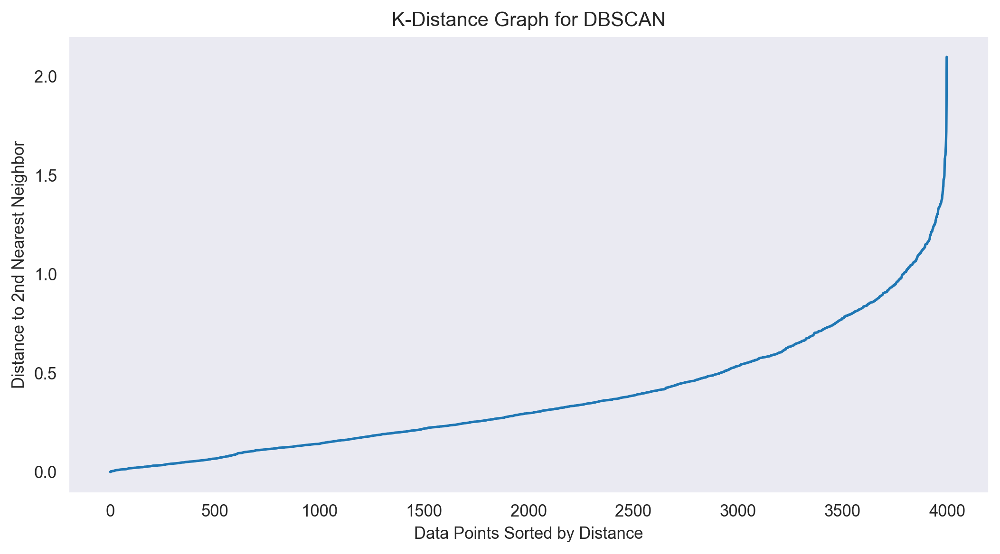

In [52]:
# Plotting the k-distance graph
plt.figure()
plt.plot(distances)
plt.title('K-Distance Graph for DBSCAN')
plt.xlabel('Data Points Sorted by Distance')
plt.ylabel('Distance to 2nd Nearest Neighbor')
plt.grid()

In [53]:
epsilon = float(input("Enter the optimal epsilon value based on the graph: "))
min_samples = 5

Enter the optimal epsilon value based on the graph:  0.3


In [54]:
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
dbscan_labels = dbscan.fit_predict(x)

In [55]:
dbscan_silhouette = silhouette_score(x, dbscan_labels) if len(set(dbscan_labels)) > 1 else -1
print(f'Silhouette Score for DBSCAN: {dbscan_silhouette}')

Silhouette Score for DBSCAN: -0.35035425689789385


# Visualizations for Clustering Results

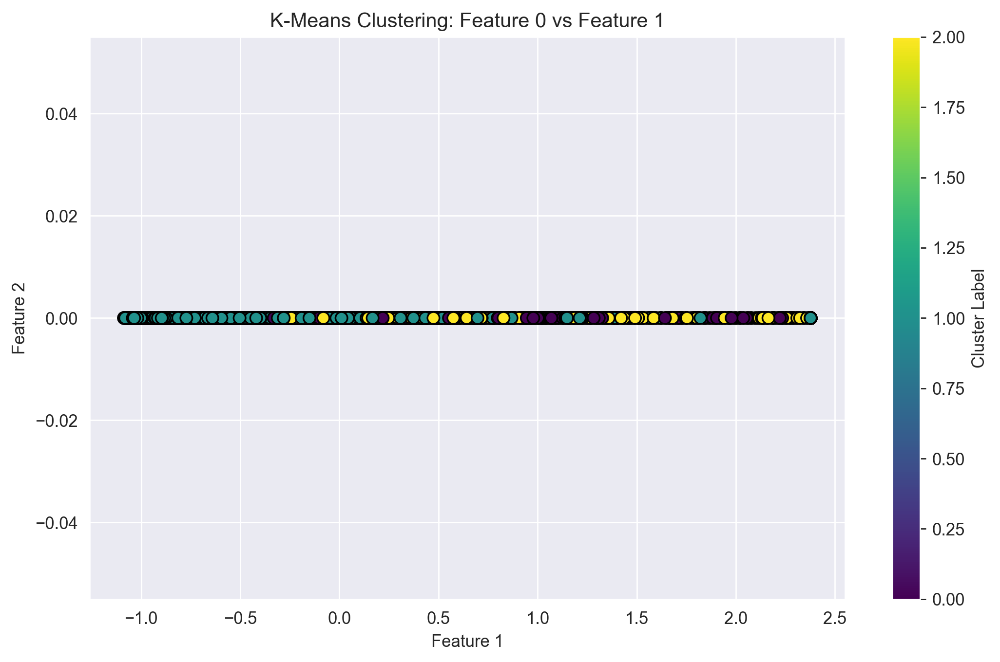

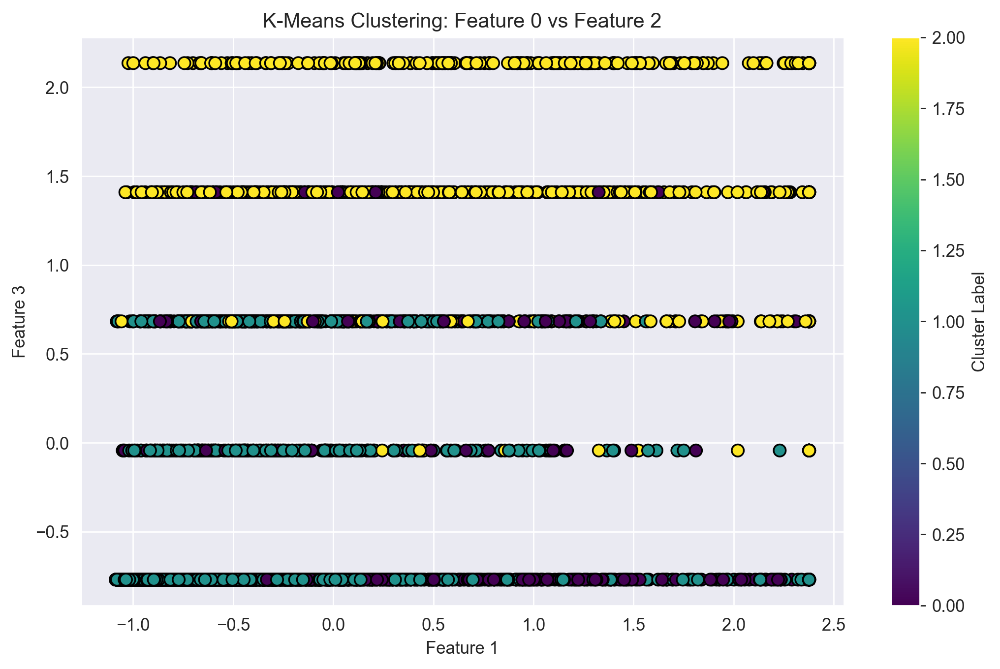

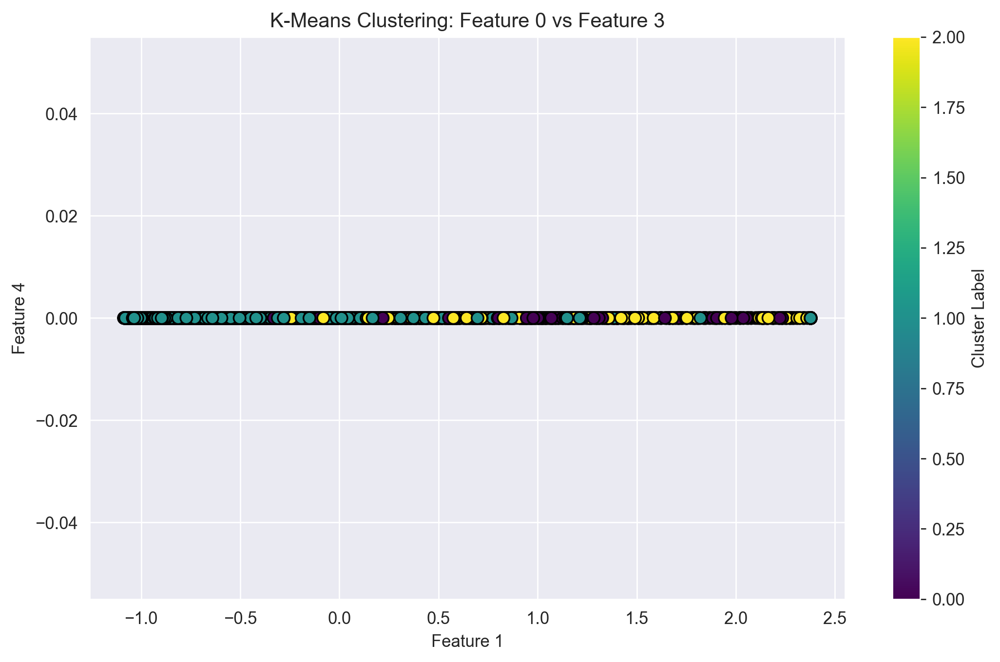

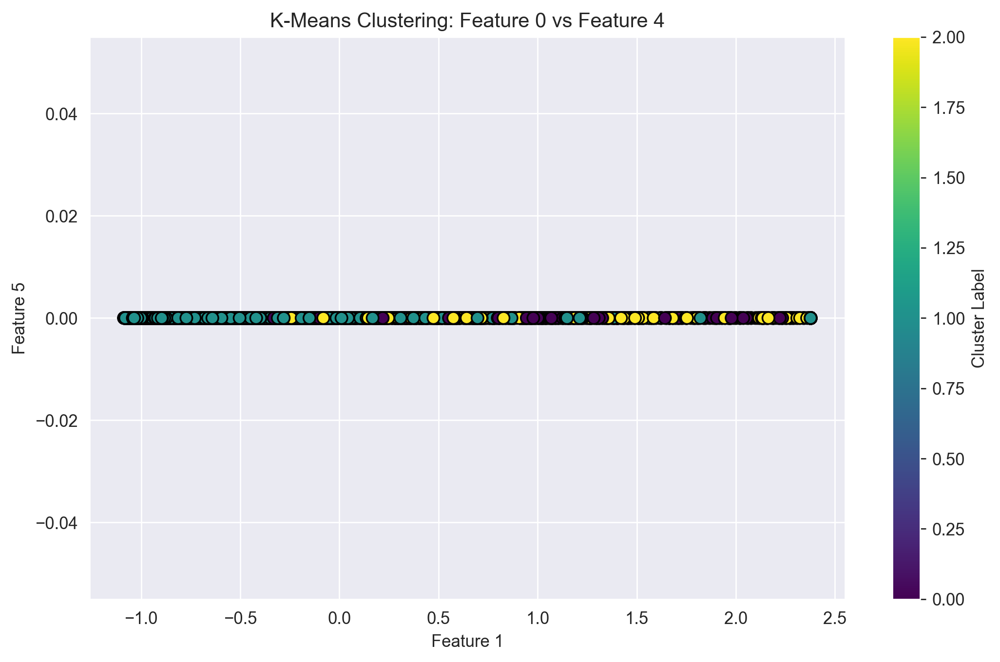

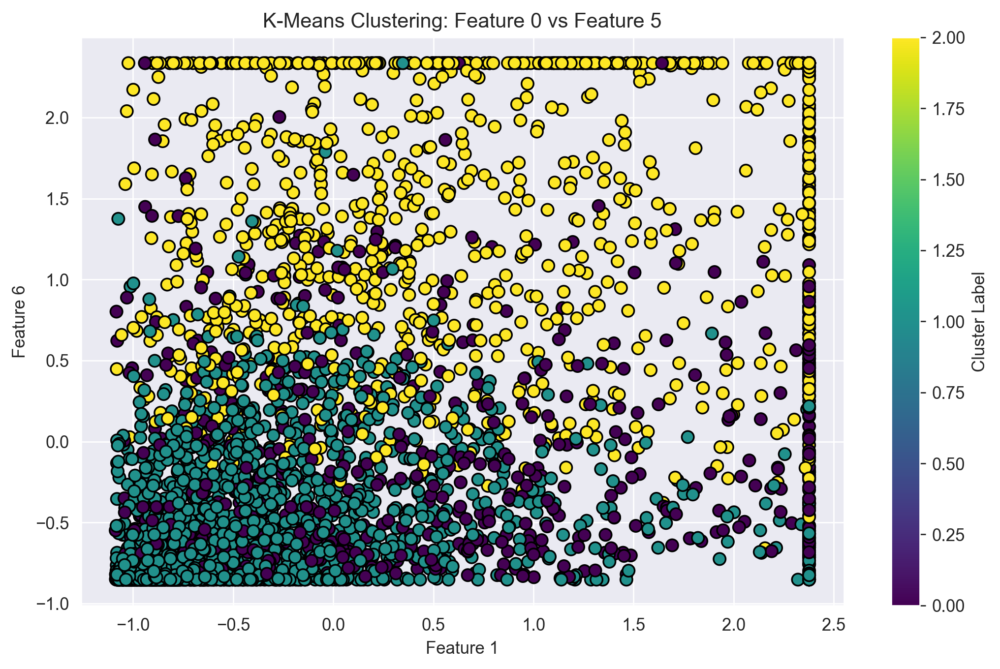

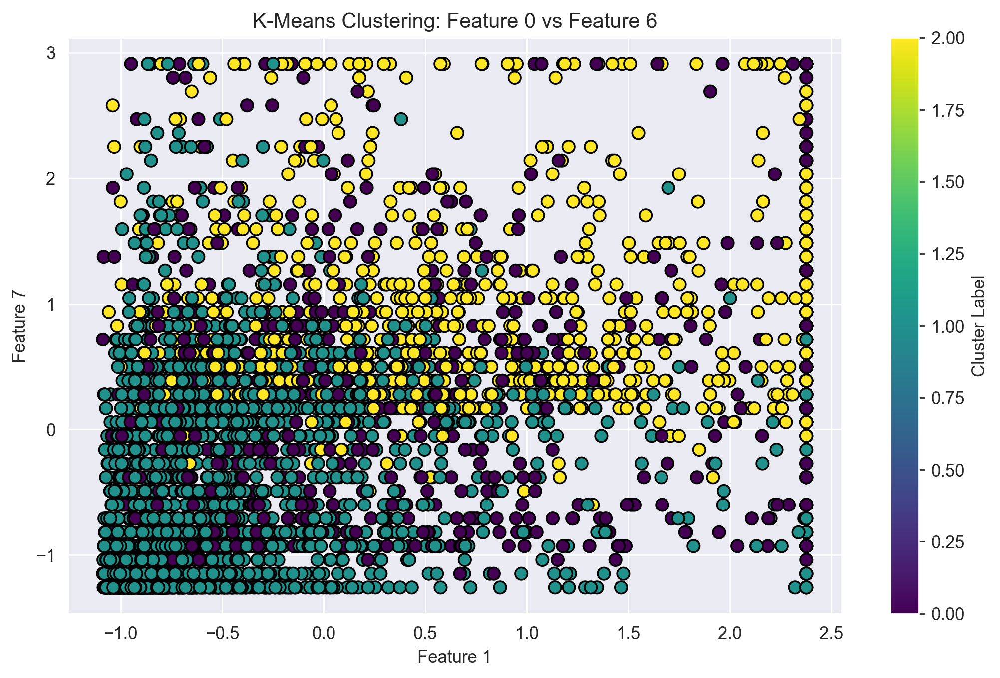

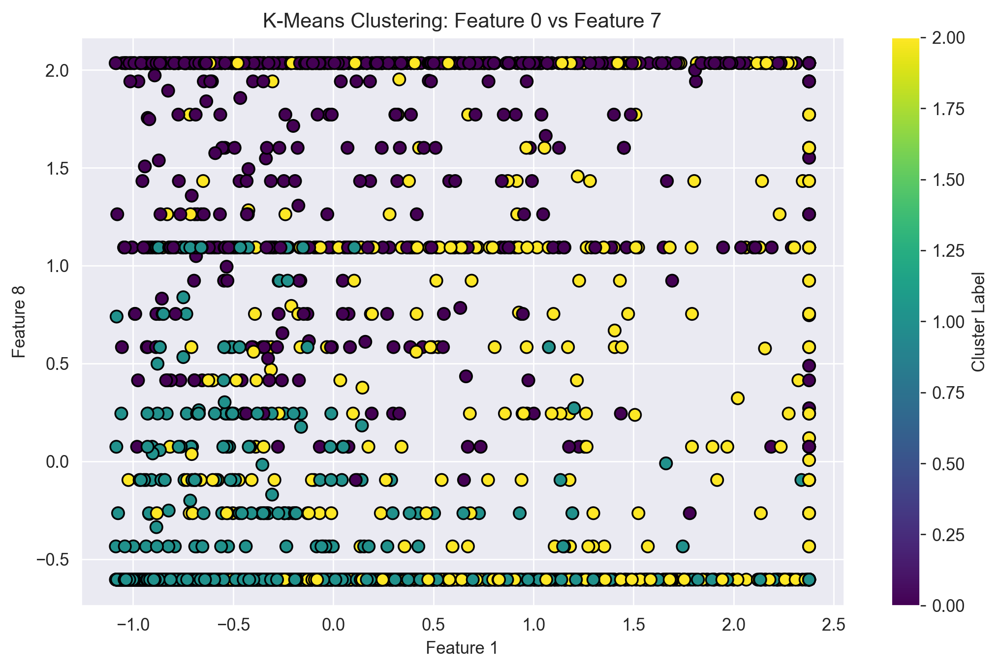

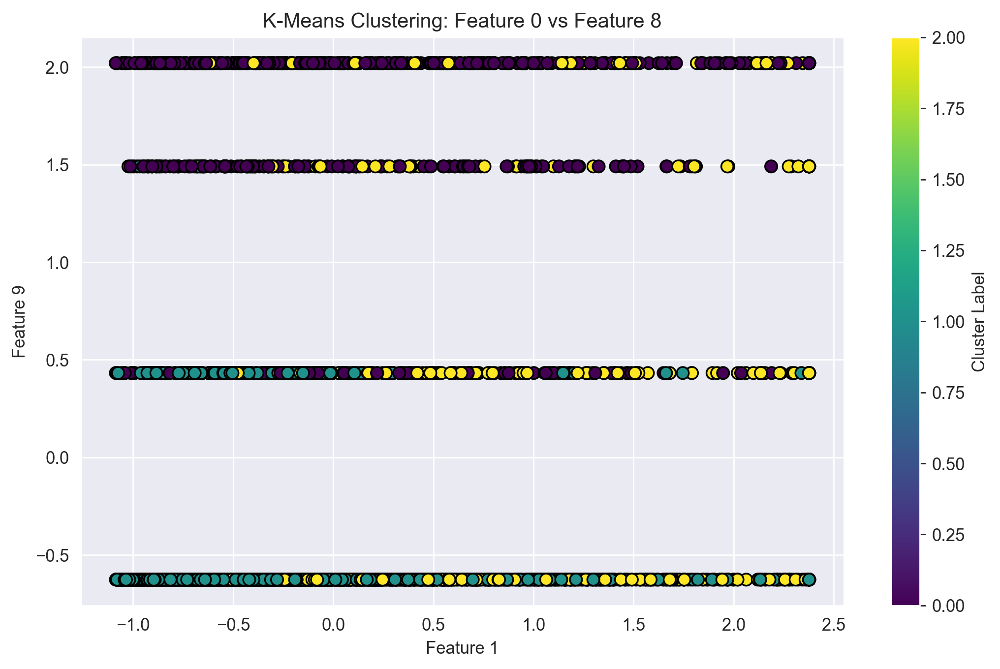

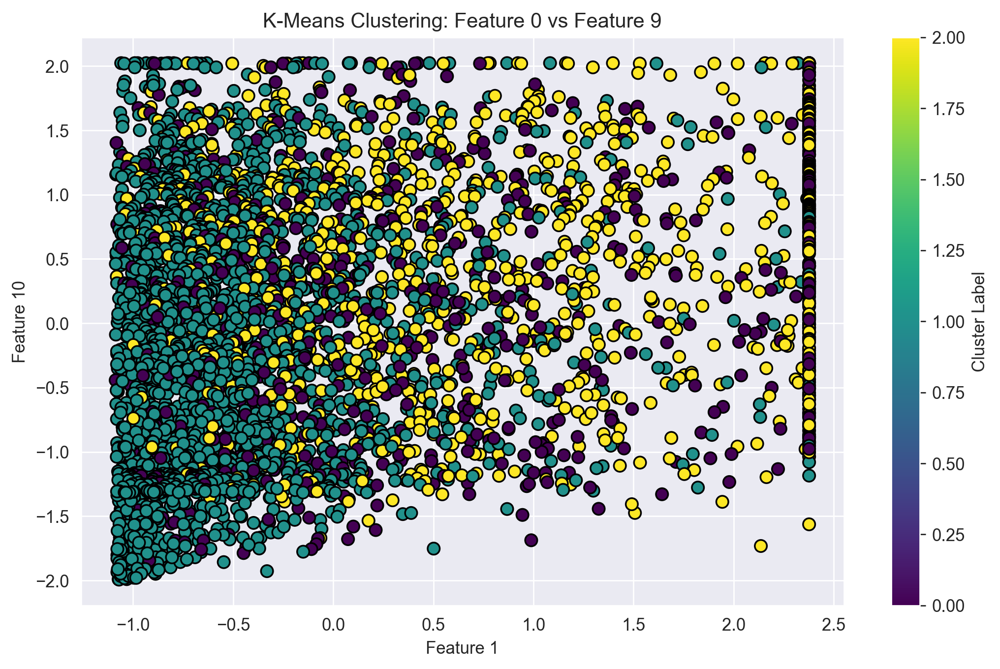

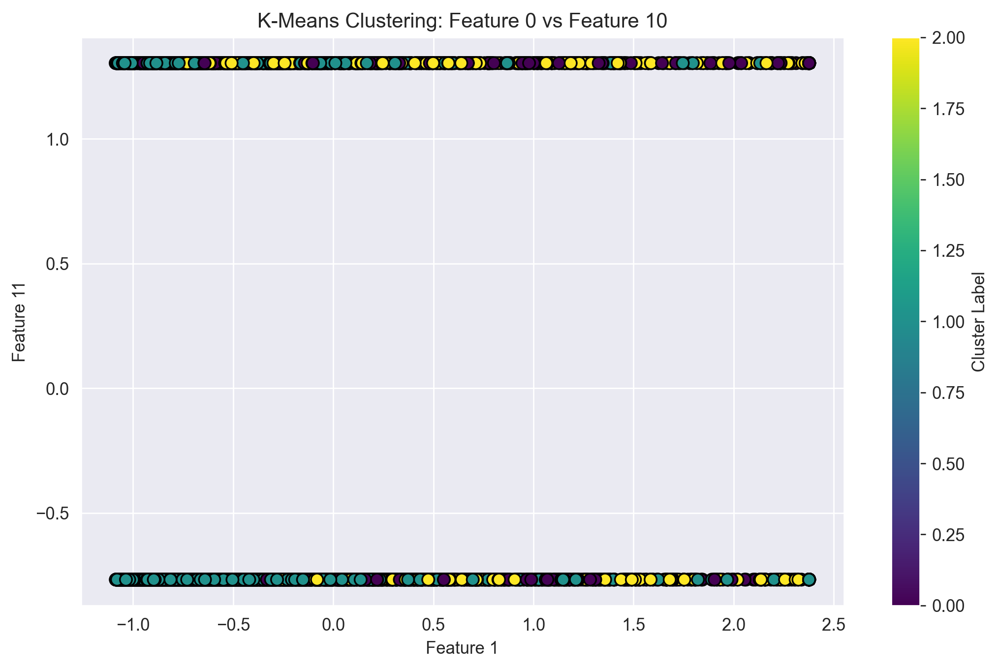

In [57]:
# For K-Means Clustering

num_features = x.shape[1]

for i in range(1, num_features):
    plt.figure(figsize=(10, 6))
    plt.scatter(x[:, 0], x[:, i], c=kmeans_labels, cmap='viridis', marker='o', edgecolor='k', s=50)
    plt.title(f'K-Means Clustering: Feature 0 vs Feature {i}')
    plt.xlabel('Feature 1')
    plt.ylabel(f'Feature {i + 1}')
    plt.colorbar(label='Cluster Label')

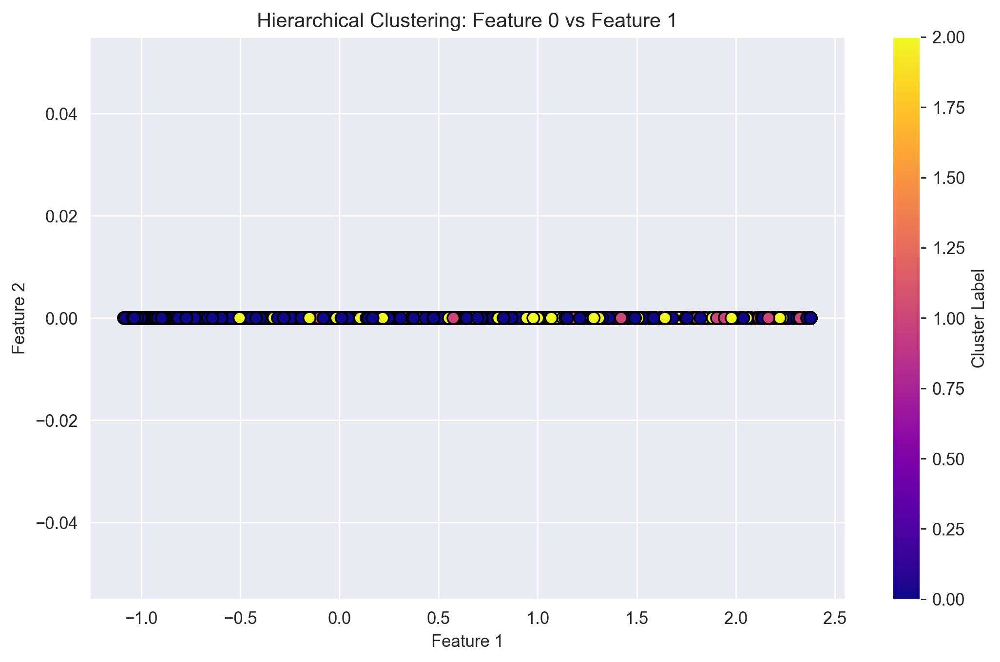

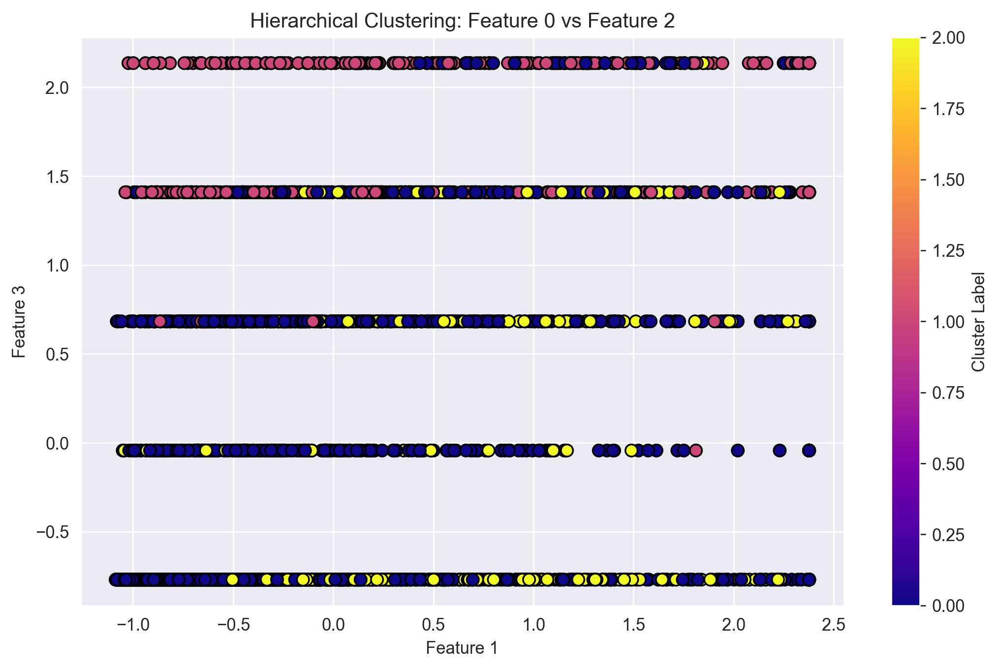

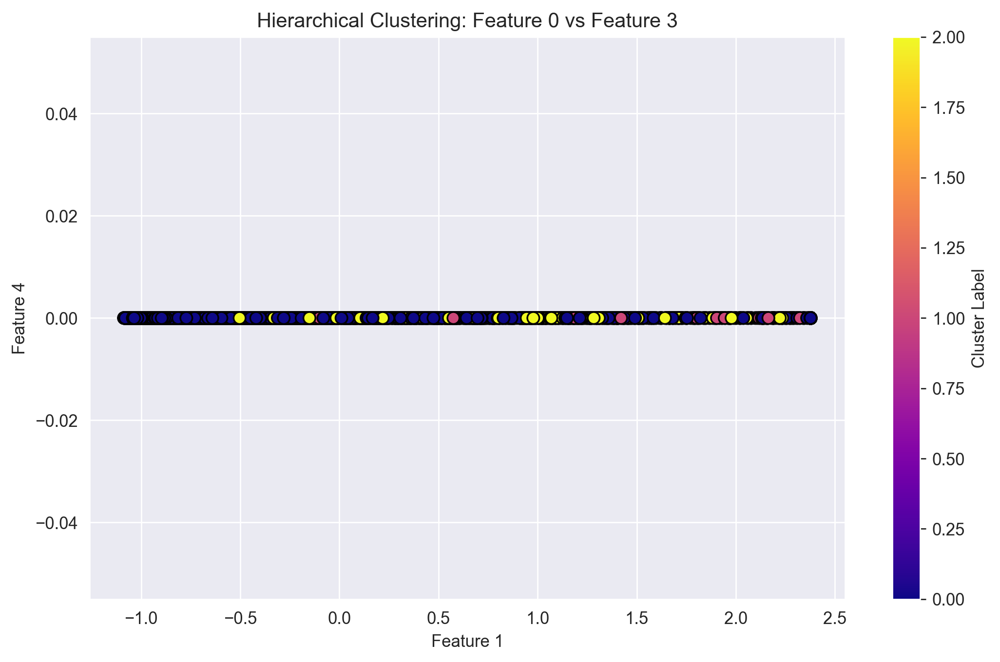

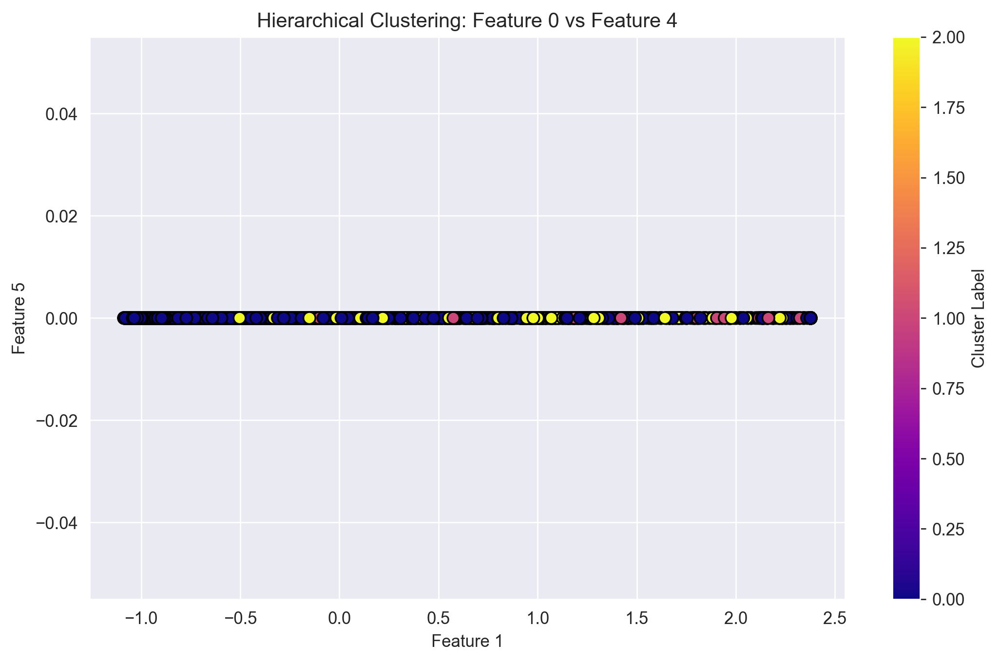

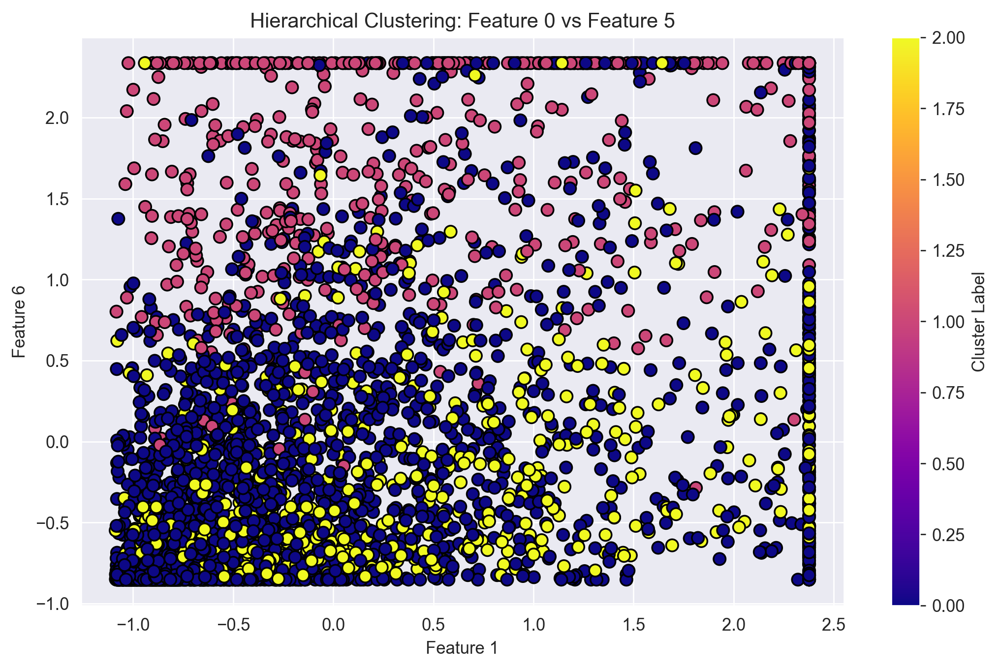

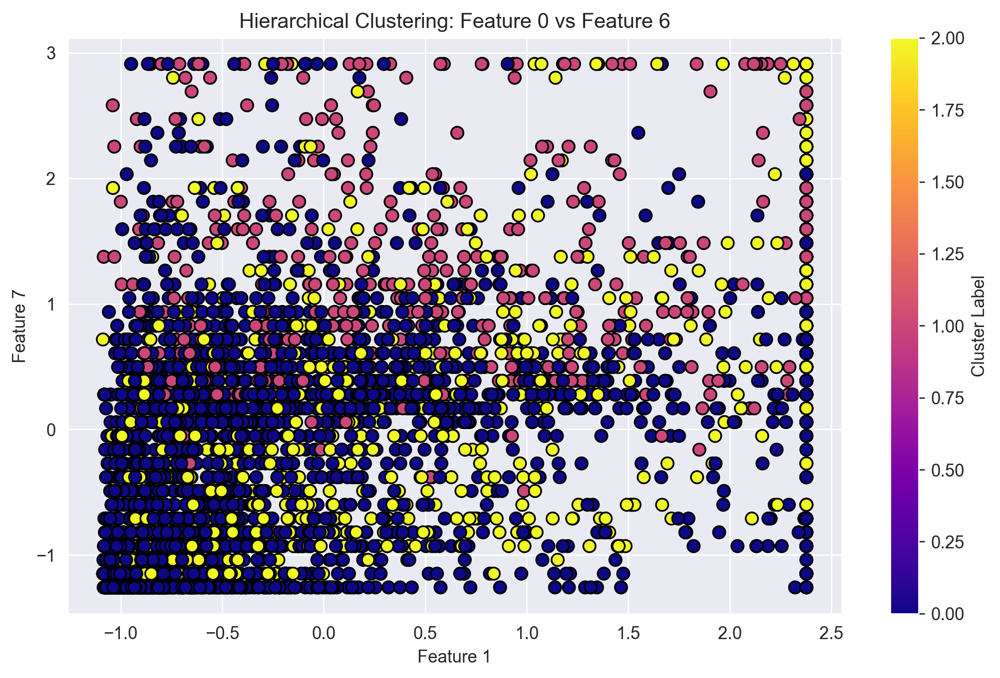

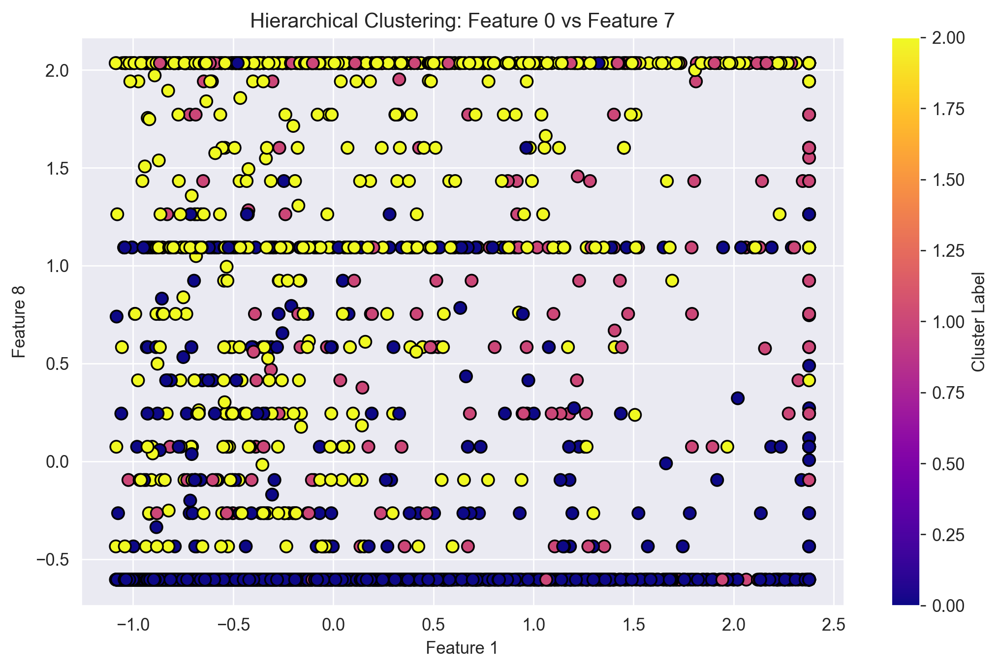

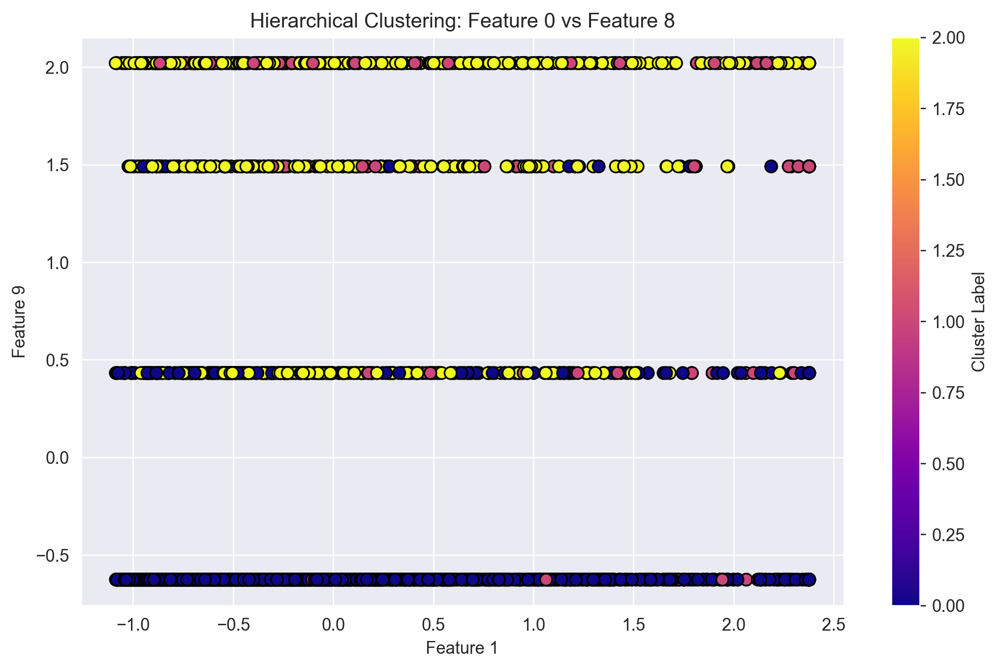

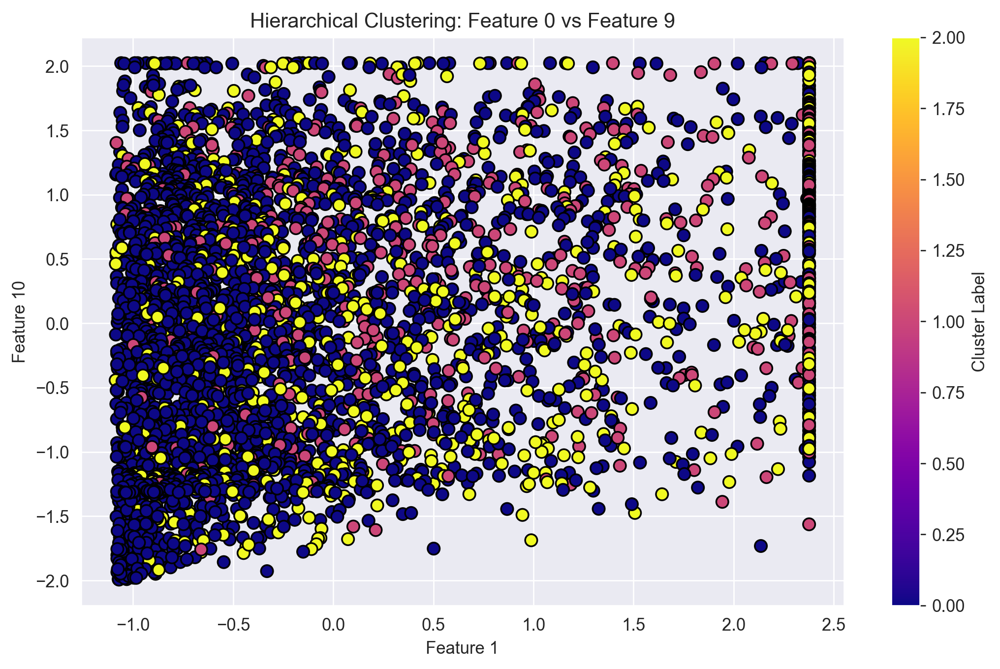

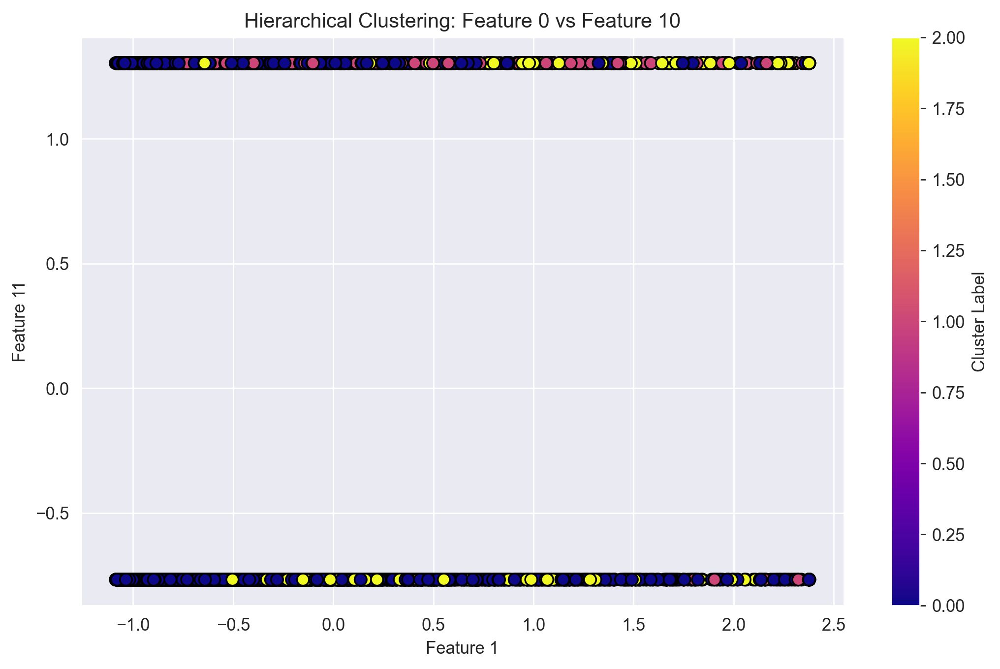

In [58]:
# For Hierarchical Clustering

for i in range(1, num_features):
    plt.figure(figsize=(10, 6))
    plt.scatter(x[:, 0], x[:, i], c=hierarchical_labels, cmap='plasma', marker='o', edgecolor='k', s=50)
    plt.title(f'Hierarchical Clustering: Feature 0 vs Feature {i}')
    plt.xlabel('Feature 1')
    plt.ylabel(f'Feature {i + 1}')
    plt.colorbar(label='Cluster Label')

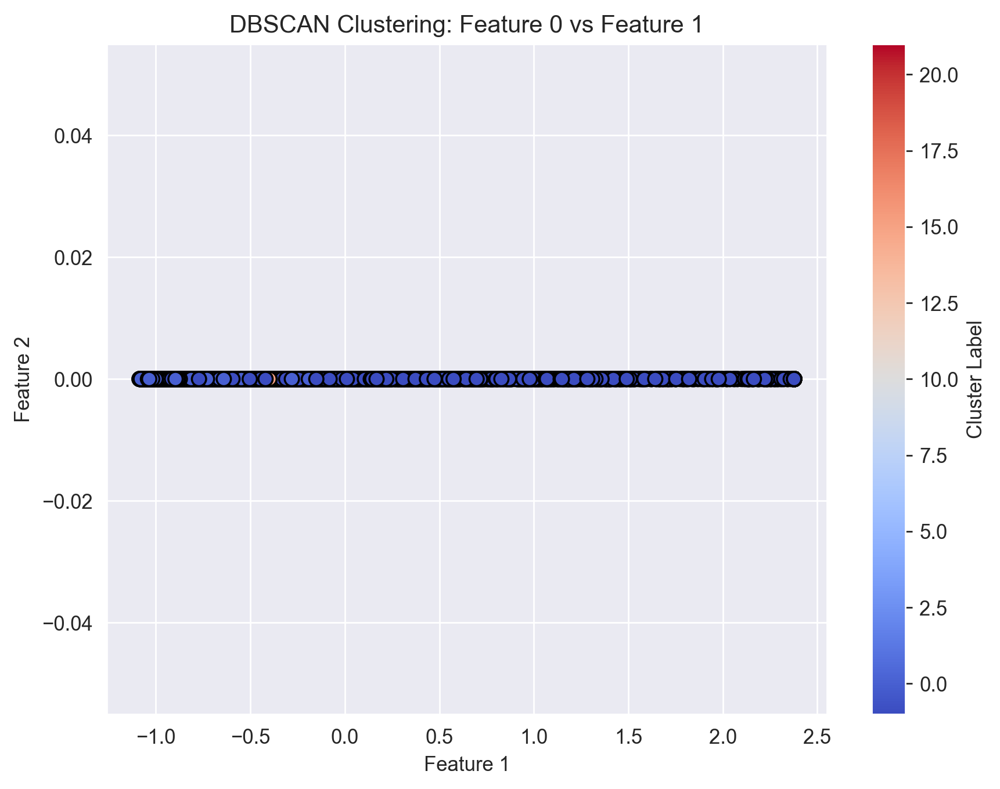

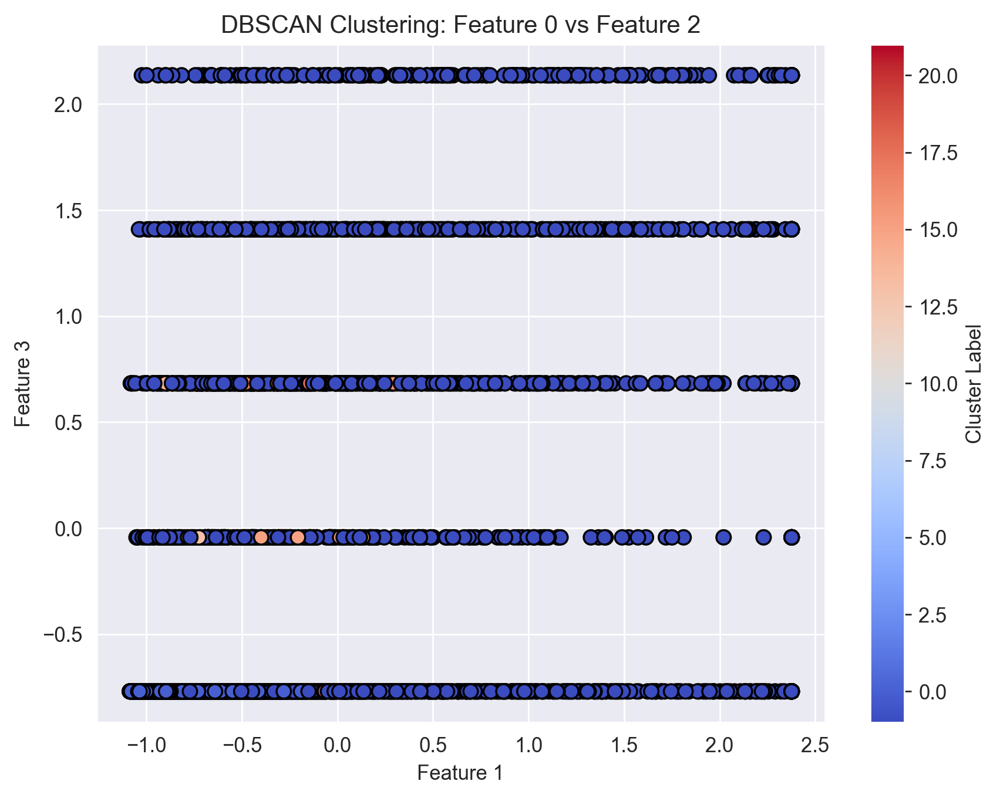

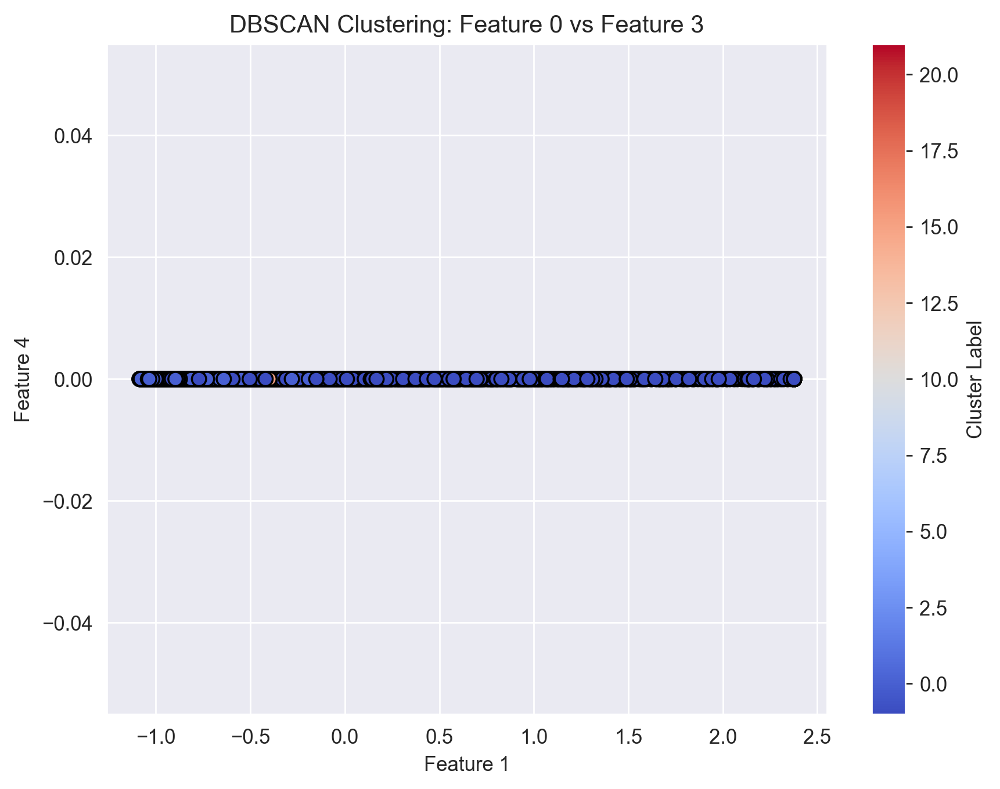

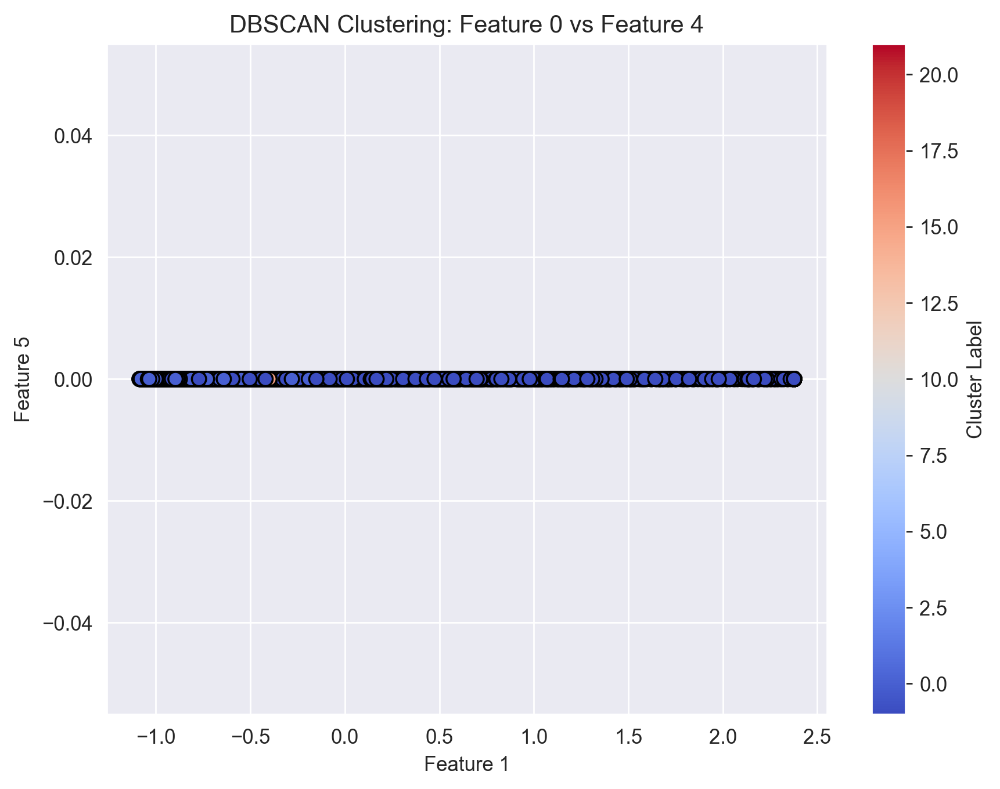

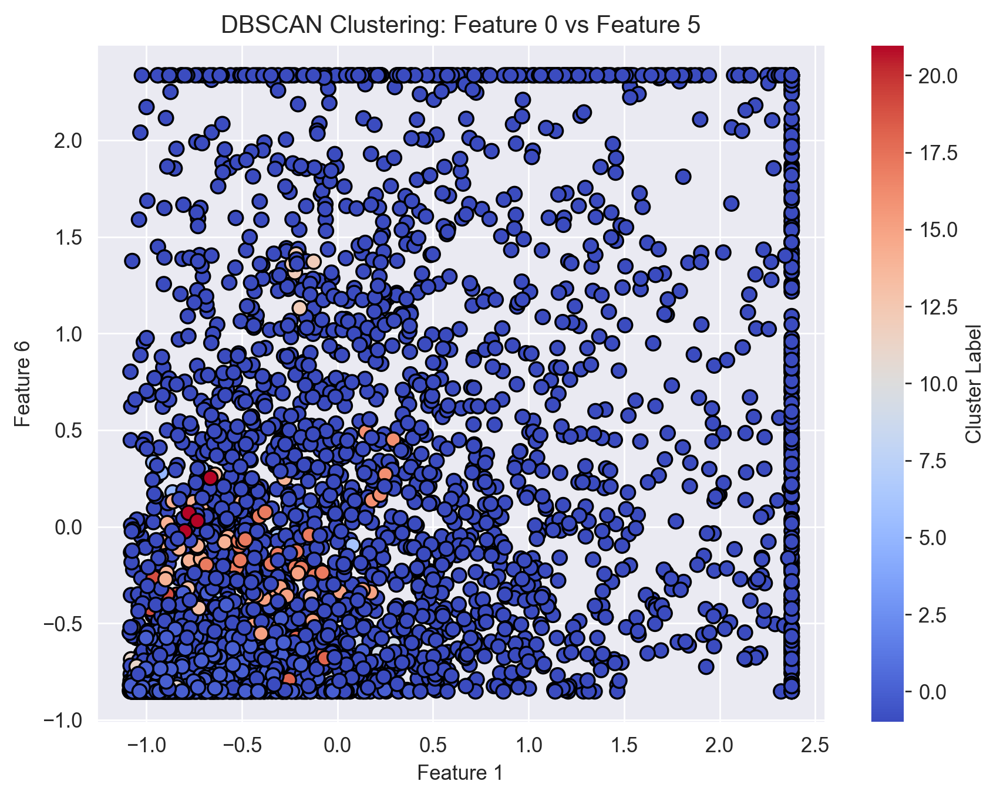

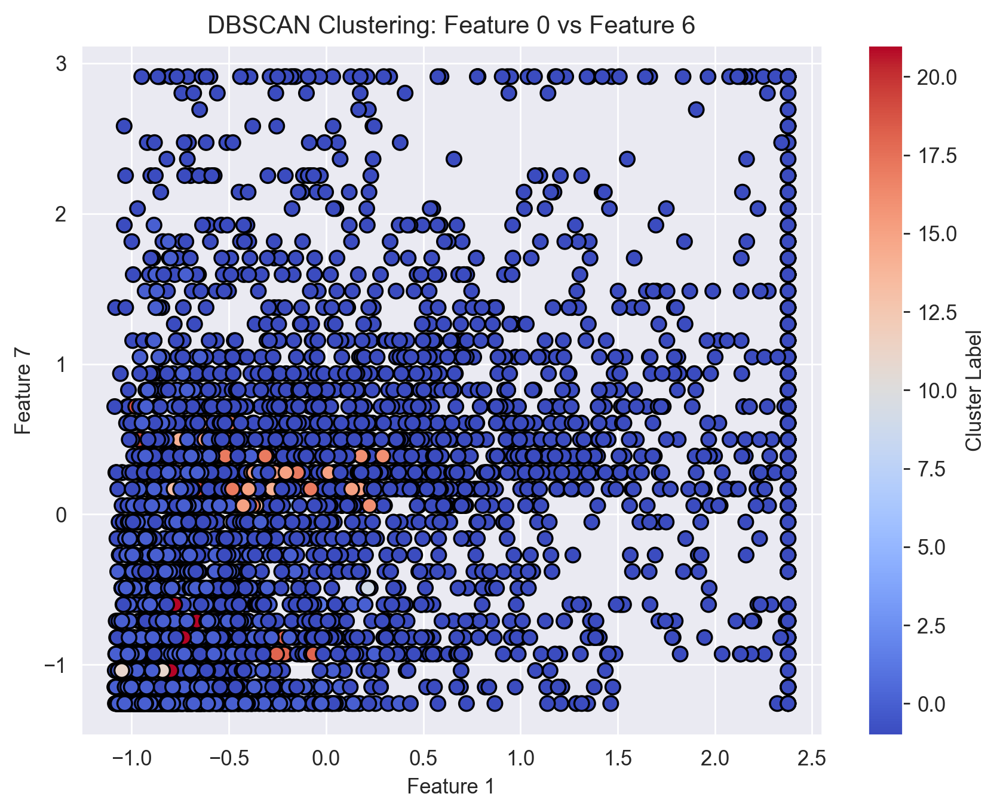

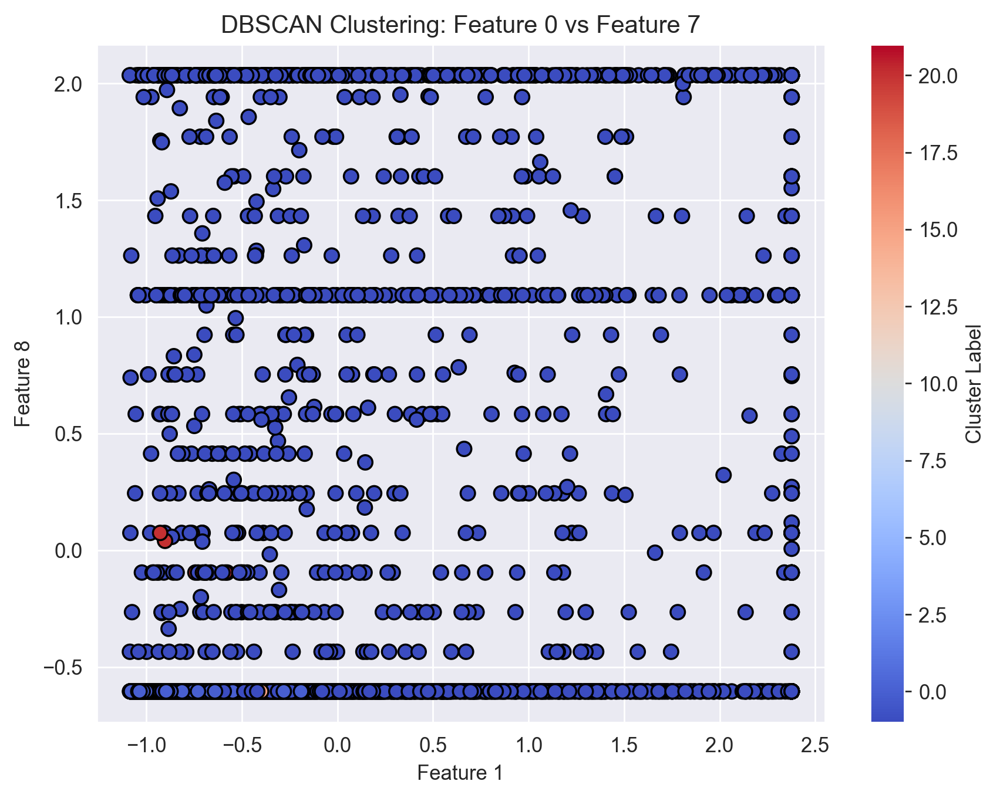

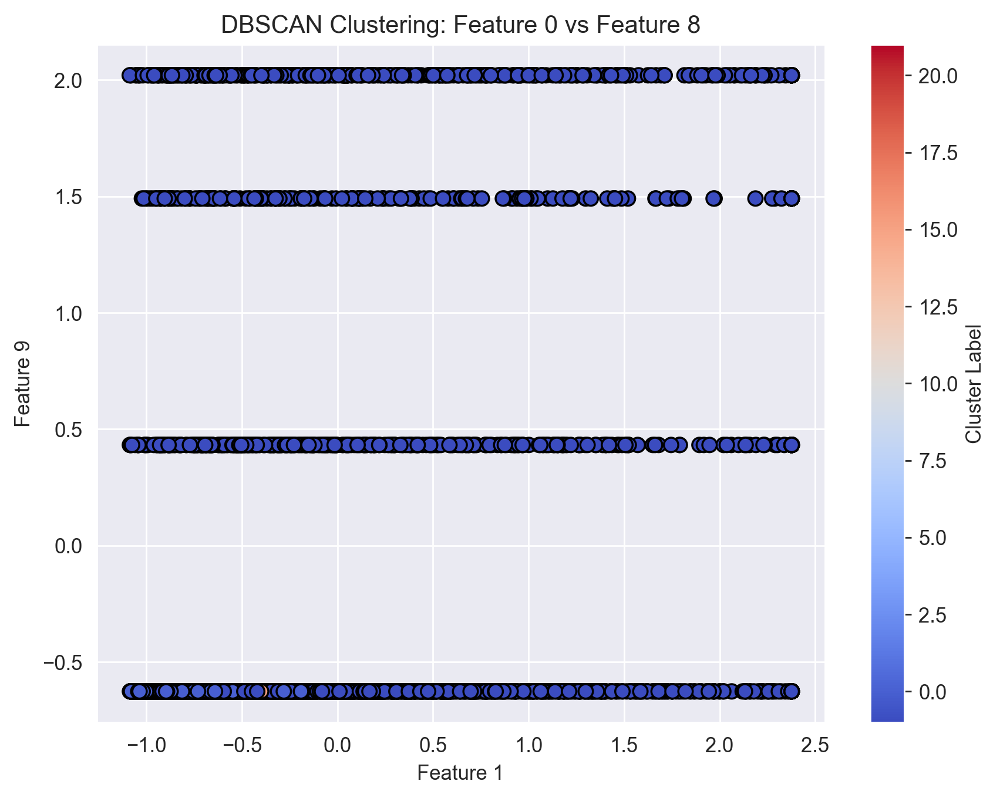

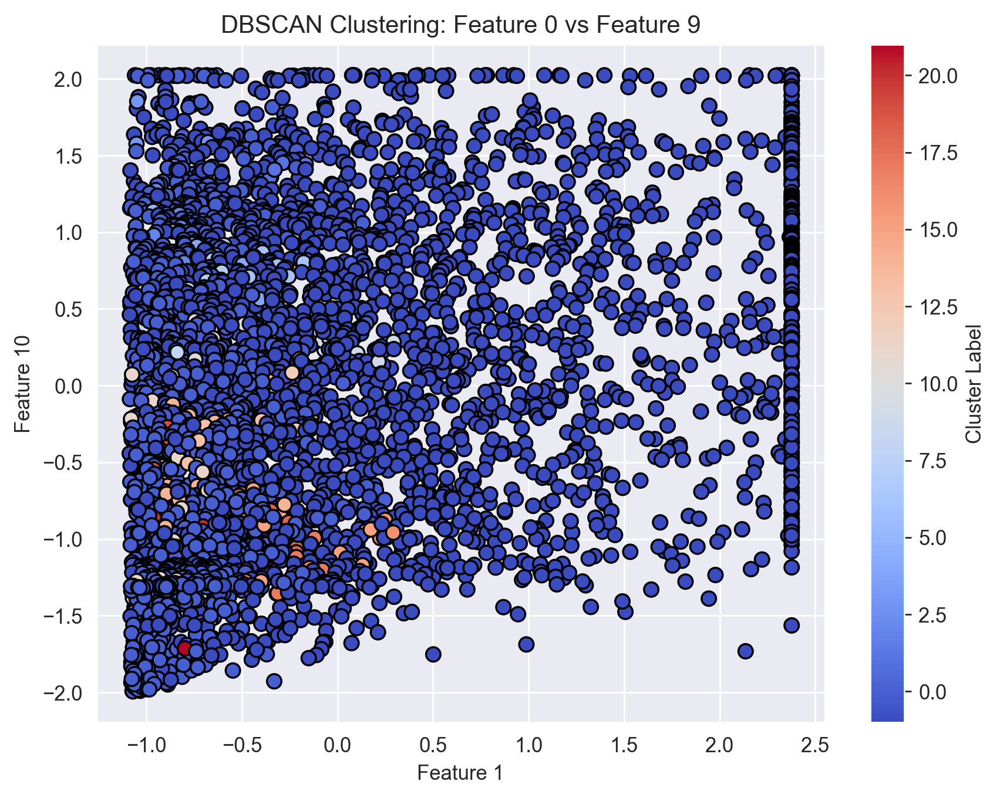

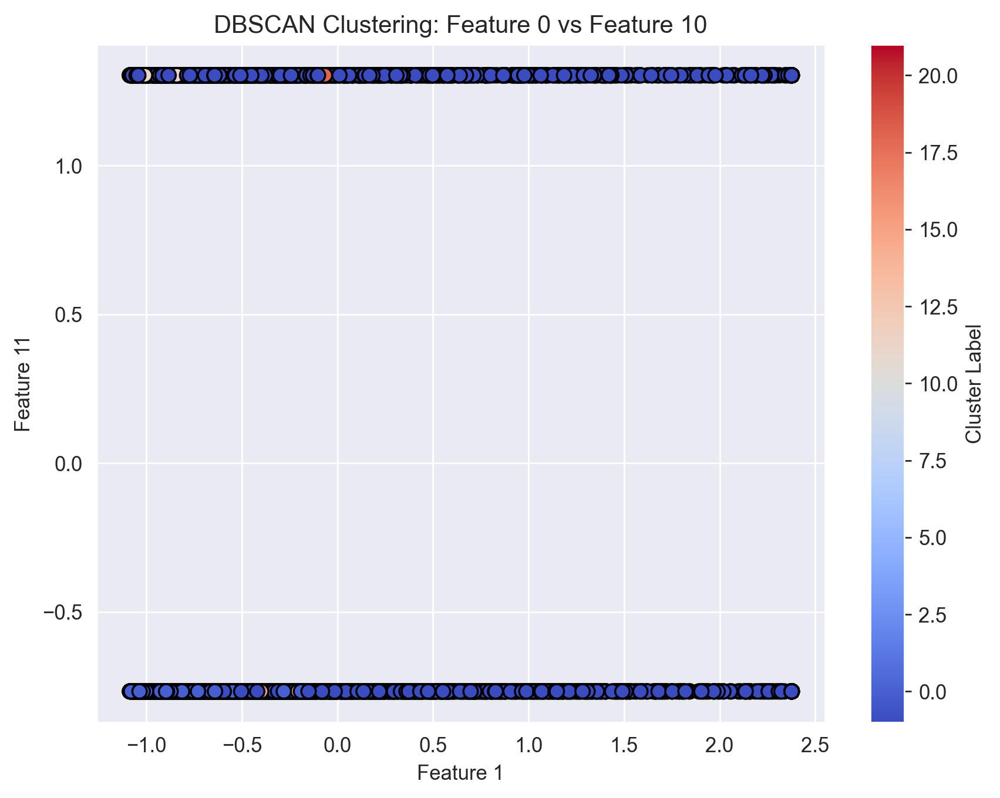

In [59]:
# For DBScan Clustering

for i in range(1, num_features):
    plt.figure(figsize=(8, 6))
    plt.scatter(x[:, 0], x[:, i], c=dbscan_labels, cmap='coolwarm', marker='o', edgecolor='k', s=50)
    plt.title(f'DBSCAN Clustering: Feature 0 vs Feature {i}')
    plt.xlabel('Feature 1')
    plt.ylabel(f'Feature {i + 1}')
    plt.colorbar(label='Cluster Label')

# Evaluation For Each Clustering Methods

In [61]:
# Evaluate silhouette score for K-Means Clustering

silhouette_kmeans = silhouette_score(x, kmeans_labels)
print(f'Silhouette Score for K-Means: {silhouette_kmeans}')

Silhouette Score for K-Means: 0.32931591228742907


In [62]:
# Evaluate silhouette score for Hierarchical Clustering

silhouette_hierarchical = silhouette_score(x, hierarchical_labels)
print(f'Silhouette Score for Hierarchical Clustering: {silhouette_hierarchical}')

Silhouette Score for Hierarchical Clustering: 0.25553610801899945


In [63]:
# Evaluating silhouette score for DBScan Clustering

if len(set(dbscan_labels)) > 1:  # Check if there are more than one cluster
    dbscan_silhouette = silhouette_score(x, dbscan_labels)
    print(f'Silhouette Score for DBSCAN: {dbscan_silhouette}')
else:
    print('DBSCAN did not find any clusters.')

Silhouette Score for DBSCAN: -0.35035425689789385
